## NOTEBOOK 1 - Exploratory Data Analysis :

We will try to solve **'Efficient supply allocation'** in a Ride hailing service. We will create two notebooks one for EDA and another one for feature creation and model building based on what we learn here.

**In any ML model it is a good practice to keep the EDA work seperate from feature engineering and model building because the later two needs to be created keeping resuability in mind, so like a function which is easier to consume in a python file making it a smooth process when we want to go to production, (for doing both training and inference) - We will follow the same principal here** 

With regards to this notebook the thought process is as follows 
1. BASIC EDA - So that we know what kind of detailed EDA we should do
2. Temporal analysis 
3. Spacial analysis 
4. Lag based analysis 
5. Use the observations from above 4 steps and apply them in feature creation & modeling notebook

NOTE -
1. In this notebook any EDA I do using plotly I am using a sampled data (10% data from each hour of the day to not loose representation) this is so that plotly does not fail locally on my system. Other graphs which use seaborn use all the data for visualization
2. I have tried to add a lot of comments to make it easier for the evaluator - when working in teams we might need lesser comments we don't really want the code to be too long just because there are a lot of lines for readability


## Contents & short description to get a full picture  :
* [Basic sanity checks - missing values, date range](#basic-eda)
    * [Missing values check](#missing-values) 
    * [Data description](#data-description) 
    * [Outliers](#Outlier) 
    
    <br>

* [Time based Analysis](#time-based-heading)
    * [Visualize hourly, daily and weekly demand in terms of Revenue](#hourly-weekly-daily)
    * [How hourly and daily lags relate to current demand ](#lags)

    <br>

* [Space based analysis](#space)
    * [How the demand shifts throughout the day](#hourly_space)    
    * [Zone Creation](#zones) 
       
       We need to create zones inorder to quantify areas of high vs low demand - we will first try a basic approach using only lat and long and then take revenue also into consideration. Both will use Kmeans and geohashing. There can be graph based proximity and some complex approaches like hierarchical clustering to create zones within zones which we can try, but keeping time into consideration we will not try that out. Plus this approach can give good enough results.
        <br>
        
        * [Only using Latitude and longitude](#lat_long)
            * [K means](#K-means)
            * [Geohashing](#Geohashing)
        * [Taking Revenue - Ride count into account](#zone-with-rev)
        
        <br>

* [Combination Time and Space](#corr_all_h)
    
    Correlations between the spatial distribution of rides, ride_value, and demand peaks involves combining geographic analysis with temporal and monetary trends
    
    We analyze the correlation between the spatial distribution (ride counts per zone) and ride_value to understand whether high-ride zones correlate with higher or lower ride values. Additionally, we examine the correlation between demand peaks and ride values to assess pricing strategies during high-demand times.
    <br>

    * [Analyze correlations between the spatial distribution of rides, ride_value, and demand peaks](#corr_all)
        
        <br>
        
        * [Spatial Correlation](#space-corr)
        The analysis will reveal whether zones with higher ride counts tend to have higher or lower average ride values. For example, central city zones might have higher ride counts but potentially lower average ride values due to shorter trips, while outer zones may have fewer rides but higher average values. We cluster ride start locations into zones and calculate the average ride value in each zone.
        <br>

        * [Temporal Correlation](#time-corr)
        Analyzing temporal peaks in demand, you can observe whether ride_value increases during peak demand periods (rush hours) or remains stable. This can help in optimizing dynamic pricing strategies.We identify peak demand hours and examine how the ride values fluctuate during these periods.
        <br>
        
        * [Combined Insights](#combine-corr)
        A combined spatial and temporal correlation analysis might reveal that certain high-ride areas have consistently higher values during specific times of the day, helping you optimize zone-based pricing strategies for ride-hailing.
        <br>
        
* [Conclusion and take aways for feature engineering](#conclusion)


In [1]:
import pandas as pd
import plotly.express as px
import plotly.graph_objs as go
import datetime
from plotly.subplots import make_subplots
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.cluster import KMeans
import geohash2
from sklearn.cluster import DBSCAN

In [2]:
df = pd.read_csv('robotex5.csv')
df.head(5)

,start_time,start_lat,start_lng,end_lat,end_lng,ride_value
0,2022-03-06 15:02:39.329452000,59.407910,24.689836,59.513027,24.831630,3.51825
1,2022-03-10 11:15:55.177526000,59.441650,24.762712,59.426450,24.783076,0.50750
2,2022-03-06 14:23:33.893257000,59.435404,24.749795,59.431901,24.761588,0.19025
3,2022-03-03 09:11:59.104192000,59.406920,24.659006,59.381093,24.641652,0.75600
4,2022-03-06 00:13:01.290346000,59.434940,24.753641,59.489203,24.876170,2.27100


Need to focus on predictive demand at specific time and locations 

## Basic sanity checks - missing values, date description and outliers<a class="anchor" id="basic-eda"></a>

#### Missing Value Check <a class="anchor" id="missing-values"></a>

In [3]:
missing_data = df.isnull().sum()
missing_percent = (df.isnull().sum() / len(df)) * 100
missing_summary = pd.DataFrame({'Missing Values': missing_data, 'Percentage': missing_percent})

print("Missing Value Summary:\n", missing_summary)


Missing Value Summary:
             Missing Values  Percentage
start_time               0         0.0
start_lat                0         0.0
start_lng                0         0.0
end_lat                  0         0.0
end_lng                  0         0.0
ride_value               0         0.0


#### Data Description <a class="anchor" id="data-description"></a>

In [4]:
statistics_summary = df.describe(include='all')
print("\nStatistical Summary:\n", statistics_summary)



Statistical Summary:
                            start_time      start_lat      start_lng  \
count                          627210  627210.000000  627210.000000   
unique                         622643            NaN            NaN   
top     2022-03-12 23:53:31.445166000            NaN            NaN   
freq                                4            NaN            NaN   
mean                              NaN      59.428682      24.743468   
std                               NaN       0.021764       0.056872   
min                               NaN      59.321557      24.505199   
25%                               NaN      59.418803      24.713140   
50%                               NaN      59.432069      24.744674   
75%                               NaN      59.439024      24.768115   
max                               NaN      59.566998      24.973743   

              end_lat        end_lng     ride_value  
count   627210.000000  627210.000000  627210.000000  
unique          

#### Outliers <a class="anchor" id="Outlier"></a>


Number of Outliers in ride_value:  17669


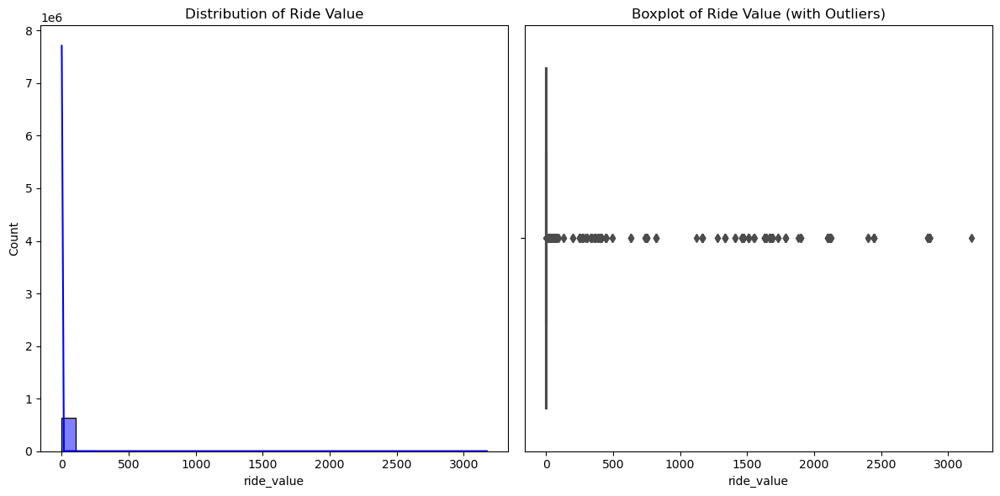

In [5]:

# Detect outliers using IQR
Q1 = df['ride_value'].quantile(0.25)
Q3 = df['ride_value'].quantile(0.75)
IQR = Q3 - Q1

# Define outlier boundaries
lower_bound = Q1 - 1.5 * IQR
upper_bound = Q3 + 1.5 * IQR

# Outliers in ride_value
outliers = df[(df['ride_value'] < lower_bound) | (df['ride_value'] > upper_bound)]
print("\nNumber of Outliers in ride_value: ", len(outliers))

plt.figure(figsize=(12, 6))

plt.subplot(1, 2, 1)
sns.histplot(df['ride_value'], kde=True, bins=30, color='blue')
plt.title('Distribution of Ride Value')

plt.subplot(1, 2, 2)
sns.boxplot(x=df['ride_value'], color='orange')
plt.title('Boxplot of Ride Value (with Outliers)')

plt.tight_layout()
plt.show()


# Time based analysis<a class="anchor" id="time-based-heading"></a>

### Visualize hourly, daily and weekly demand in terms of Revenue <a class="anchor" id="hourly-weekly-daily"></a>

In [6]:
df['start_time'] = pd.to_datetime(df['start_time'])

df['hour'] = df['start_time'].dt.hour
df['day_of_week'] = df['start_time'].dt.day_name()
df['day'] = df['start_time'].dt.date
df['week'] = df['start_time'].dt.strftime('%U')  # Year-Week format

# Aggregating ride values by hour, day, and week
hourly_agg = df.groupby('hour')['ride_value'].sum().reset_index()
daily_agg = df.groupby('day')['ride_value'].sum().reset_index()
weekly_agg = df.groupby('week')['ride_value'].sum().reset_index()

fig = make_subplots(
    rows=2, cols=2,
    subplot_titles=("Hourly Trend", "Daily Trend", "Weekly Trend"),
    specs=[[{"type": "scatter"}, {"type": "scatter"}], [{"colspan": 2}, None]]
)

fig.add_trace(
    go.Scatter(x=hourly_agg['hour'], y=hourly_agg['ride_value'], mode='lines', name='Hourly Ride Value'),
    row=1, col=1
)

fig.add_trace(
    go.Scatter(x=daily_agg['day'], y=daily_agg['ride_value'], mode='lines', name='Daily Ride Value'),
    row=1, col=2
)

fig.add_trace(
    go.Scatter(x=weekly_agg['week'], y=weekly_agg['ride_value'], mode='lines', name='Weekly Ride Value'),
    row=2, col=1
)

# Add vertical lines for weekends (Saturday and Sunday) in daily and weekly trends
weekends = daily_agg['day'][pd.to_datetime(daily_agg['day']).dt.dayofweek >= 5]

# Vertical lines for Daily Trend (Weekends)
for day in weekends:
    fig.add_vline(x=day, line_dash="dash", line_color="red", row=1, col=2)

fig.update_layout(
    title_text="Hourly, Daily, and Weekly Ride Value Trends",
    height=800, width=1000,
    showlegend=False
)

fig.show()

Hourly Trend: The first graph (on the left) shows the hourly trend.

Daily Trend: The second graph (on the right) shows the daily trend, with red vertical dashed lines representing Saturdays and Sundays.

Weekly Trend: The third graph (on the second row) shows the weekly trend, with blue dashed lines indicating weekends (assuming a weekly aggregation based on the first weekend occurrence).

Vertical Lines: For daily data, weekends are identified by checking if the day of the week is Saturday or Sunday, and for weekly data, vertical lines are added at weekly intervals.

### OBSERVATIONS
- There are peak hours like 7 AM then afternoon 2 PM and a steady demand in the evening 
- Over the weeks the demand is steadily increasing 
- We see a recurring pattern daily

### How hourly and daily lags relate to current demand <a class="anchor" id="lags"></a>

In [7]:
# Resample the data to hourly demand by aggregating ride values
df_resampled = df.resample('H', on='start_time').agg({'ride_value': 'sum'}).reset_index()

# Compute lag features for past demand
df_resampled['lag_1_hour'] = df_resampled['ride_value'].shift(1)
df_resampled['lag_2_hours'] = df_resampled['ride_value'].shift(2)
df_resampled['lag_1_day'] = df_resampled['ride_value'].shift(24)

df_resampled['lag_3_hours'] = df_resampled['ride_value'].shift(3)
df_resampled['lag_2_days'] = df_resampled['ride_value'].shift(24*2)
df_resampled['lag_7_days'] = df_resampled['ride_value'].shift(24*7)

df_resampled.dropna(inplace=True)

print(df_resampled.head())

             start_time   ride_value   lag_1_hour  lag_2_hours    lag_1_day  \
168 2022-03-08 00:00:00   862.181951  3574.777750  1023.533750   692.315041   
169 2022-03-08 01:00:00   712.939359   862.181951  3574.777750  2352.552975   
170 2022-03-08 02:00:00   566.067838   712.939359   862.181951   423.012274   
171 2022-03-08 03:00:00  1217.514478   566.067838   712.939359   327.057750   
172 2022-03-08 04:00:00   515.031287  1217.514478   566.067838   398.131250   

     lag_3_hours   lag_2_days  lag_7_days  
168   934.935250  2446.751408  2380.39900  
169  1023.533750   740.371618  2258.55875  
170  3574.777750   458.336453  2136.67825  
171   862.181951   328.215000   347.71650  
172   712.939359   506.535750   475.89050  


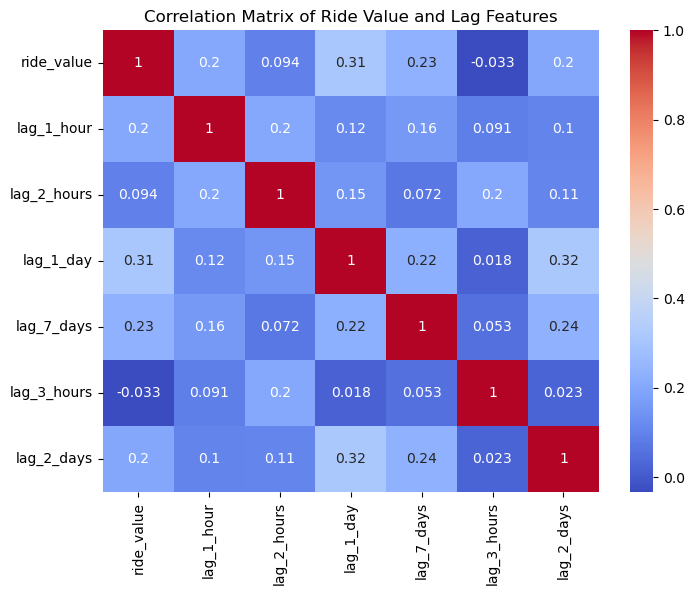

In [8]:
correlation = df_resampled[['ride_value', 'lag_1_hour', 'lag_2_hours', 'lag_1_day', 'lag_7_days', 'lag_3_hours', 'lag_2_days']].corr()

plt.figure(figsize=(8, 6))
sns.heatmap(correlation, annot=True, cmap='coolwarm')
plt.title('Correlation Matrix of Ride Value and Lag Features')
plt.show()

### OBSERVATIONS
Intutively it makes sense that 1 day and 7 days are more correlated to current ride value compared to 3 hour back 
but we can make use of 1 hour or 30 min prior value 

# Space based analysis<a class="anchor" id="space"></a>

This dataset is from Estonia if we take all the data together but we have a better representation below.
Few observations 
1. The hottest zone is the city center , airport
2. there are zones which are practacally empty - probably residencial suburbs no so many starting point of a ride


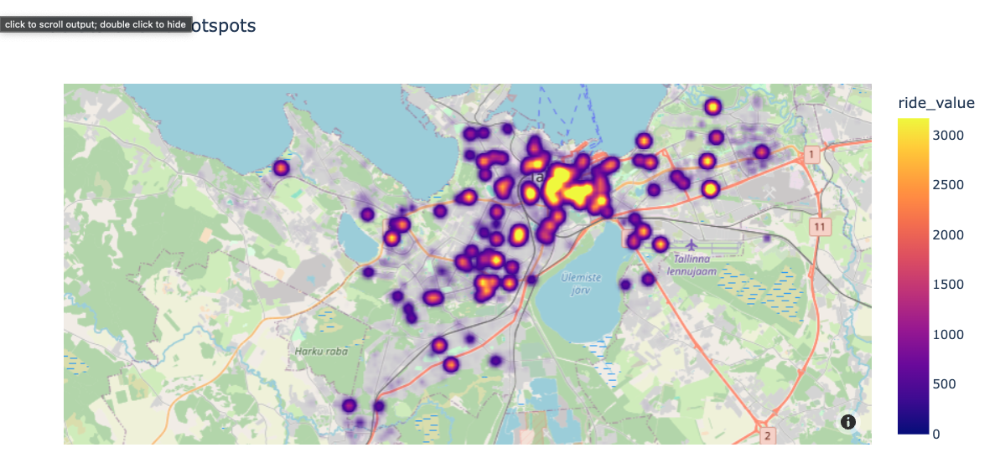

## How the demand shifts throughout the day<a class="anchor" id="hourly_space"></a> 
1. The current dataset is large for plotly to handle so we will take a 10% fraction from each hour
2. There are outliers which can skew the data when plotting - so we will remove those using Inter quartile range 

In [9]:
# Function to sample 10% of the data for each hour
df['hour_of_day'] = df['start_time'].dt.hour

def sample_10_percent(group):
    return group.sample(frac=0.1)

# Apply the sampling function to each group (each hour)
df_sampled = df.groupby('hour_of_day', group_keys=False).apply(sample_10_percent)

df_sampled = df_sampled.sort_values(by='hour_of_day')

In [10]:
# Filter the DataFrame to remove outliers
# Calculate Q1 (25th percentile) and Q3 (75th percentile)
Q1 = df_sampled['ride_value'].quantile(0.25)
Q3 = df_sampled['ride_value'].quantile(0.75)

IQR = Q3 - Q1

lower_bound = Q1 - 1.5 * IQR
upper_bound = Q3 + 1.5 * IQR

df_filtered = df[(df['ride_value'] >= lower_bound) & (df['ride_value'] <= upper_bound)]

In [11]:
max_ride_value = df_filtered['ride_value'].max()
min_ride_value = df_filtered['ride_value'].min()

mean_ride_value = df_filtered['ride_value'].mean()
median_ride_value = df_filtered['ride_value'].median()
mode_ride_value = df_filtered['ride_value'].median()

print('min ride value: ' + str(min_ride_value) )
print('max ride value: ' + str(max_ride_value) )

print('mean ride value: ' + str(mean_ride_value) )
print('median ride value: ' + str(median_ride_value) )
print('mode ride value: ' + str(mode_ride_value) )


min ride value: 0.1076276647445139
max ride value: 3.469
mean ride value: 1.1663787140957753
median ride value: 1.02725
mode ride value: 1.02725


In [ ]:
min_ride_value = df_filtered['ride_value'].min()
max_ride_value = df_filtered['ride_value'].max()*10 
df_filtered = df_filtered.sort_values(by='hour_of_day')

# Create the density mapbox plot with time-based animation
fig = px.density_mapbox(
    df_filtered, 
    lat='start_lat', 
    lon='start_lng', 
    z='ride_value',  # Weight points by ride value
    radius=8,  # Control the spread of each point
    center=dict(lat=59.407910, lon=24.809836),  
    zoom=9.5,  # Adjust the zoom level
    mapbox_style="open-street-map", 
    animation_frame='hour_of_day',  # Time-based animation
    range_color=[min_ride_value, max_ride_value],
    title="Dynamic Ride Start Point Hotspots Over Time"
)

fig.update_layout(
    width=1000,  
    height=800   
)

fig.show()

### OBSERVATIONS
1. like we saw in the hourly demand above - hours from 7 - 10 and then afternoon and evening hours are peak demand time
2. There are hot spots like - airport - the sea port terminal - city center

Let us note down important host spots and their lat long - we will use proximity to these places as features later on 
1. Tallinn bus station - 59.4274, 24.7740
2. Old City Harbor (Port of Tallinn) - 59.4475, 24.7664 
3. Airport - 59.4146, 24.8335
4. city center tallinn estonia - 59.4370, 24.7536
5. Tammsaare Business Centre - 59.4017, 24.7160
6. Foorum Shopping Centre - 59.4375° , 24.7583° 

There can be more but this should be a good start 


In [13]:
df.groupby(['start_lat','start_lng'])[['start_time']].count().sort_values('start_time', ascending = False).head(10)

,,start_time
start_lat,start_lng,
59.436705,24.782963,13
59.430689,24.721561,11
59.440582,24.747974,11
59.439357,24.761589,10
59.428259,24.750050,10
59.431077,24.718880,10
59.438532,24.758186,10
59.428552,24.765640,10
59.441140,24.736913,10


## ZONE CREATION<a class="anchor" id="zones"></a> 

#### 1. ONLY USING LATITUDE AND LONGITUDE 
    This is a naive approach but very simple to visualize - we will use this just to visualize how many rides can be clustered together only using geo location. 
    
#### 2. TAKING REVENUE - RIDE COUNT INTO ACCOUNT 
    We will build upon step 1 but we will take into account our buisness and revenue generation feature ie ride count/ride value. This will help us create zones using historical data. We will use these zones later on to help navigate drivers to maximize serving of the demand 


#### 1. ONLY USING LATITUDE AND LONGITUDE<a class="anchor" id="lat_long"></a> 
##### K means<a class="anchor" id="k-means"></a>  

In [ ]:
locations = df_sampled[['start_lat', 'start_lng']]

# Apply K-Means Clustering to cluster the locations into n zones 

n_clusters = 10  
kmeans = KMeans(n_clusters=n_clusters, random_state=42)
df_sampled['zone'] = kmeans.fit_predict(locations).astype('str')

fig = px.scatter_mapbox(
    df_sampled,
    lat="start_lat",
    lon="start_lng",
    color="zone",  # Color the points by their assigned zone
    mapbox_style="open-street-map",
    zoom=10,
    title=f"Ride Start Locations Clustered into {n_clusters} Zones",
    center=dict(lat=59.407910, lon=24.809836)
)

fig.update_layout(
    width=900,
    height=800
)

fig.show()


#### Geohashing<a class="anchor" id="Geohashing"></a> 

In [15]:
# Function to apply geohashing
def apply_geohash(lat, lng, precision=5):
    return geohash2.encode(lat, lng, precision)

# Apply geohashing to the start_lat and start_lng columns
df_sampled['geohash'] = df_sampled.apply(lambda row: apply_geohash(row['start_lat'], row['start_lng']), axis=1)

fig_geohash = px.scatter_mapbox(
    df_sampled,
    lat="start_lat",
    lon="start_lng",
    color="geohash",  # Color the points by their geohash region
    mapbox_style="open-street-map",
    zoom=10,
    title="Ride Start Locations Grouped by Geohash",
    center=dict(lat=59.407910, lon=24.809836)
)

fig_geohash.update_layout(width=900, height=800)
fig_geohash.show()

### OBSERVATIONS
- Both K means and geo hashing are able to group locations into different zones - I think the geo hashing is doing a better job but it is currently a bit meaningless unless we take revenue into consideration. 

#### 2. TAKING REVENUE - RIDE COUNT INTO ACCOUNT<a class="anchor" id="zone-with-rev"></a> 

Geohashing + K - means 

In [16]:
ride_counts = df_sampled.groupby('geohash').size().reset_index(name='ride_count')

df_sampled = df_sampled.merge(ride_counts, on='geohash', how='left')

# Create features for clustering (latitude, longitude, and ride_count)
geohash_data = df_sampled[['start_lat', 'start_lng', 'ride_count']]

# Apply K-Means clustering with ride count influencing the clustering
n_clusters = 40 
kmeans = KMeans(n_clusters = n_clusters)
df_sampled['zone'] = kmeans.fit_predict(geohash_data).astype(str)
df_sampled['zone_with_val'] = df_sampled['zone'] + ' - RIDE COUNT: ' + df_sampled['ride_count'].astype(str)

/Users/akshaypaliwal/anaconda3/lib/python3.11/site-packages/sklearn/cluster/_kmeans.py:1412: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning



In [17]:
df_sampled = df_sampled.sort_values(by = 'ride_count', ascending = False)

In [18]:
fig = px.scatter_mapbox(
    df_sampled,
    lat="start_lat", lon="start_lng",
    color="zone_with_val",
    mapbox_style="open-street-map",
    zoom=10,
    center=dict(lat=59.407910, lon=24.809836),
    title="Zones Based on Ride Counts and Location"
)
fig.update_layout(width=900, height=800)
fig.show()

In [19]:
def find_optimal_clusters(df, lat_column, lng_column, ride_count_column='ride_count', max_clusters=100):
    """
    This function finds the optimal number of clusters for K-Means clustering using the Elbow Method.

    Parameters:
    df (pd.DataFrame): Input DataFrame containing lat/lng coordinates and ride count
    lat_column (str): Column name for latitude
    lng_column (str): Column name for longitude
    ride_count_column (str): Column name for ride count (default is 'ride_count')
    max_clusters (int): Maximum number of clusters to test (default is 10)

    Returns:
    None: Displays a plot of the Elbow Method to help choose the optimal number of clusters
    """
    
    # Prepare the data for K-Means clustering (latitude, longitude, and ride count)
    kmeans_input = df[[lat_column, lng_column, ride_count_column]]
    
    # List to hold the WCSS (inertia) values for different cluster sizes
    wcss = []
    
    # Fit K-Means with different numbers of clusters (from 1 to max_clusters)
    for k in range(1, max_clusters + 1):
        kmeans = KMeans(n_clusters=k)
        kmeans.fit(kmeans_input)
        # Append the WCSS (inertia) to the list
        wcss.append(kmeans.inertia_)
    
    # Plot the WCSS values to visualize the Elbow
    plt.figure(figsize=(8, 6))
    plt.plot(range(1, max_clusters + 1), wcss, marker='o')
    plt.title('Elbow Method for Optimal Clusters')
    plt.xlabel('Number of Clusters')
    plt.ylabel('WCSS (Inertia)')
    plt.grid(True)
    plt.show()


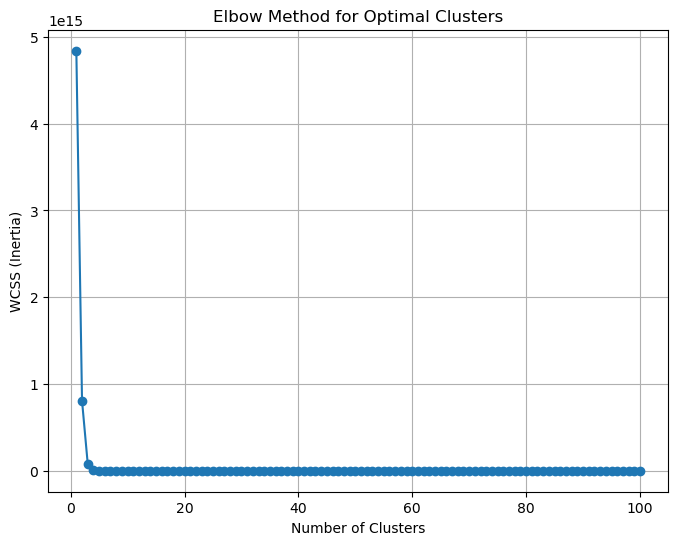

Although using elbow method the number of clusters needs to be less than 10 but in practical terms we will take many more things into account when seggrigating multiple zones. like number of drivers, current news information etc. so we will probably have more zones - this was just to depeict how we can find the number of zones we need in a naive sense but lets take 40 zones when implementing our solution. 
this being a variable can be changed if the results does not suit our requirnments

### Combination Time and Space<a class="anchor" id="corr_all_h"></a>

#### Analyze correlations between the spatial distribution of rides, ride_value, and demand peaks<a class="anchor" id="corr_all"></a>

Correlations between the spatial distribution of rides, ride_value, and demand peaks involves combining geographic analysis with temporal and monetary trends

We analyze the correlation between the spatial distribution (ride counts per zone) and ride_value to understand whether high-ride zones correlate with higher or lower ride values. Additionally, we examine the correlation between demand peaks and ride values to assess pricing strategies during high-demand times.

WE WILL BE USING THE ZONES WE CREATED USING GEOSPACIAL + K MEANS TAKING RIDE COUNT INTO ACCOUNT 

#### Spatial Correlation<a class="anchor" id="space-corr"></a>
 The analysis will reveal whether zones with higher ride counts tend to have higher or lower average ride values. For example, central city zones might have higher ride counts but potentially lower average ride values due to shorter trips, while outer zones may have fewer rides but higher average values.

We cluster ride start locations into zones and calculate the average ride value in each zone.

In [20]:
zone_ride_value = df_sampled.groupby('zone_with_val')['ride_value'].mean().reset_index()

fig = px.scatter_mapbox(
    df_sampled,
    lat="start_lat",
    lon="start_lng",
    color="zone_with_val",
    size="ride_value",  # Use ride value to represent the size of the points
    mapbox_style="open-street-map",
    zoom=10,
    title="Spatial Distribution of Rides with Ride Value and Zones",
    center=dict(lat=59.407910, lon=24.809836)
)
fig.show()

#### Temporal Correlation<a class="anchor" id="time-corr"></a>
By analyzing temporal peaks in demand, you can observe whether ride_value increases during peak demand periods (rush hours) or remains stable. This can help in optimizing dynamic pricing strategies.

We identify peak demand hours and examine how the ride values fluctuate during these periods.

In [21]:
# Calculate total rides per hour and average ride value per hour
hourly_demand = df.groupby('hour').agg(ride_count=('ride_value', 'size'), avg_ride_value=('ride_value', 'mean')).reset_index()

fig = make_subplots(specs=[[{"secondary_y": True}]])

fig.add_trace(
    go.Bar(x=hourly_demand['hour'], y=hourly_demand['ride_count'], name="Ride Count", marker_color='blue'),
    secondary_y=False
)

fig.add_trace(
    go.Scatter(x=hourly_demand['hour'], y=hourly_demand['avg_ride_value'], name="Avg Ride Value", mode='lines+markers', line=dict(color='red')),
    secondary_y=True
)

fig.update_layout(
    title_text="Demand Peaks and Ride Value by Hour",
    xaxis_title="Hour of the Day",
    height=600, width=1000
)

fig.update_yaxes(title_text="Ride Count", secondary_y=False)
fig.update_yaxes(title_text="Avg Ride Value (Currency)", secondary_y=True)

fig.show()

#### OBSERVATION 
- This makes sense because odd hours ride like 12AM to 4AM in the night or 11PM in the night should be expensive 
- Also the number of rides at odd hours are less compared to other hours

#### Combined Insights<a class="anchor" id="combine-corr"></a>
        A combined spatial and temporal correlation analysis might reveal that certain high-ride areas have consistently higher values during specific times of the day, helping you optimize zone-based pricing strategies for ride-hailing.

In [22]:
# till now we calculated over a sampled dataset so that we can let plotly do its job 
# NOW WE WILL APPLY THE CLUSTERING K MEANS + GEOHASH ON TOP OF ALL THE DATA 
df['geohash'] = df.apply(lambda row: apply_geohash(row['start_lat'], row['start_lng']), axis=1)

df_ride_counts = df.groupby('geohash').size().reset_index(name='ride_count')

df = df.merge(df_ride_counts, on='geohash', how='left')

geohash_df = df[['start_lat', 'start_lng', 'ride_count']]

n_clusters = 40
kmeans = KMeans(n_clusters = n_clusters)
df['zone'] = kmeans.fit_predict(geohash_df).astype(str)
df['zone_with_val'] = df['zone'] + ' - RIDE COUNT: ' + df['ride_count'].astype(str)

df.head(2)


/Users/akshaypaliwal/anaconda3/lib/python3.11/site-packages/sklearn/cluster/_kmeans.py:1412: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning



,start_time,start_lat,start_lng,end_lat,end_lng,ride_value,hour,day_of_week,day,week,hour_of_day,geohash,ride_count,zone,zone_with_val
0,2022-03-06 15:02:39.329452,59.40791,24.689836,59.513027,24.831630,3.51825,15,Sunday,2022-03-06,10,15,ud99c,48789,6,6 - RIDE COUNT: 48789
1,2022-03-10 11:15:55.177526,59.44165,24.762712,59.426450,24.783076,0.50750,11,Thursday,2022-03-10,10,11,ud9d5,226447,1,1 - RIDE COUNT: 226447


In [23]:
# Analyze the correlation between ride density and ride value
ride_density = df.groupby('zone')['ride_value'].size().reset_index(name='ride_count')

zone_ride_value = df.groupby('zone')['ride_value'].mean().reset_index()

zone_correlation = zone_ride_value.merge(ride_density, on='zone')

correlation = zone_correlation.corr()
print(correlation)

fig = px.scatter(zone_correlation, x='ride_count', y='ride_value', 
                 title='Correlation between Ride Count and Ride Value per Zone', color = 'zone')
fig.show()

                zone  ride_value  ride_count
zone        1.000000    0.159716   -0.504851
ride_value  0.159716    1.000000   -0.181712
ride_count -0.504851   -0.181712    1.000000


In [24]:
# Analyze the correlation between demand peaks and ride value
# Calculate correlation between ride count and average ride value per hour
correlation_temporal = hourly_demand[['ride_count', 'avg_ride_value']].corr()
print(correlation_temporal)

hourly_demand_cp = hourly_demand
hourly_demand_cp['hour'] = hourly_demand_cp['hour'].astype('str')

fig = px.scatter(hourly_demand_cp, x='ride_count', y='avg_ride_value', 
                 title='Correlation between Demand Peaks and Ride Value', color = 'hour')
fig.show()

                ride_count  avg_ride_value
ride_count         1.00000         0.16504
avg_ride_value     0.16504         1.00000


## Conclusion and take aways for feature creation<a class="anchor" id="conclusion"></a>

1. Temporal Features - Time of the day definately matters - we knew this intutively but we not have data which helps us quantify and prove our assumption

    Kind of temporal features which we can use - Hour of the day, day of the week, is_holiday, is_weekend
    <br>

2. Spatial Feaures - These too matter as we saw some regions have high ride value and some are just more active than others - we need to quantify those like we did above 
    We will try to get features like - Zone ids, distance from city centeer, proximity to popular zones
    <br>

3. Lag features - As we saw above lags from prior hour or prior day helps a lot in real time demand 
    Features like 1 hour, 1 day and 7 days etc will help
    <br>

4. Ride value - Aggregated metrics like average ride value per zone and time.


